## <span style="color: red;">CatchPhish</span> - An ML Approach to URL Phishing Detection
<br>

### Sprint 2 - Notebook 2

<br>

#### Author: Omar Kreidie


## <a id ='0'></a>
## Table of Contents: 

1. [Business Context](#1)
2. [Data Information + Data Dictionary](#2)
3. [Libraries](#3)
4. [Notebook Expectations](#4)
5. [Data Dictionary + Info](#5)
6. [EDA](#6)
7. [Preprocessing](#7)
    - [Variance Thresholding](#9)
    - [Correlation Analysis](#10)
    - [Recursive Feature Elimination](#11)
    - [PCA](#15)
    
8. [Preliminary/Baseline Modeling](#8)
    - [Logistic Regression Model](#12)
    - [Decision Tree Classifier](#13)
    - [Random Forest Classifier](#14)

## Business Context <a id="1"></a>

### Libraries <a id="3"></a>

In [1]:
#Data frames + Array libraries
import pandas as pd
import numpy as np 

#Plotting Libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

#Statistics libraries
from scipy import stats
from scipy.stats import norm 

#Preprocessing libraries for cleaning and tokenzing 
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize
import re
import string
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

#Sklearn model library for logistic regression + preprocessing
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from sklearn.feature_selection import VarianceThreshold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from sklearn.inspection import permutation_importance


#Modelling libraries for the DecisionTree + PCA Pipeline
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix

from warnings import filterwarnings
filterwarnings(action='ignore')

[nltk_data] Downloading package punkt to /Users/kreidie/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


### What to find in the notebook: <a id="4"></a>
In this sprint, the goal is to expand on what was built in the Data Wrangling stage. Given that a majority of the work completed was EDA, this notebook will aim to find and build visuals for more complex relationships within the dataset, preprocess for modelling, and build baseline models. 

(1) EDA, find complex relationships and build visualizations
<br>(2) Preprocess the dataset using feature reduction techniques 
<br>(3) Build 3 baseline classification models (no optimization) starting with Logistic Regression, Random Forest, and ___ 

# Data Information + Data Dictionary <a id="5"></a>
### Brief overview:
The data was retrieved from [PHIUSIIL Phishing URL Dataset](https://archive.ics.uci.edu/dataset/967/phiusiil+phishing+url+dataset). The dataset has 235,795 Rows and 56 Features. The target feature is the 'label' common which is binary. 0 = Phishing and 1 = Legitimate. The data is fairly evenly split, which avoids class imbalance, helping us build a stronger predictive model. there are 134850 Legitimate and 100945 Phishing URL's. 

<br> The data dictionary contains a basic descritpion. In the sections below where I analyse the features, I provide definitions where needed. 


### Data Dictionary

| Column Name                  | Data Type  | Description |
|------------------------------|-----------|-------------|
| **FILENAME**                 | object    | Name of the file containing the URL. |
| **URL**                      | object    | The full URL being analyzed. |
| **URLLength**                | int64     | Length of the URL in characters. |
| **Domain**                   | object    | The domain name extracted from the URL. |
| **DomainLength**             | int64     | Length of the domain name. |
| **IsDomainIP**               | int64     | Indicator if the domain is an IP address (1 = Yes, 0 = No). |
| **TLD**                      | object    | The top-level domain (e.g., .com, .org). |
| **URLSimilarityIndex**       | float64   | Similarity score of the URL compared to known legitimate domains. |
| **CharContinuationRate**     | float64   | Measure of continuous character sequences in the URL. |
| **TLDLegitimateProb**        | float64   | Probability that the TLD belongs to a legitimate site. |
| **URLCharProb**              | float64   | Probability of character distribution in the URL being legitimate. |
| **TLDLength**                | int64     | Length of the top-level domain. |
| **NoOfSubDomain**            | int64     | Number of subdomains in the URL. |
| **HasObfuscation**           | int64     | Indicates if the URL contains obfuscation techniques (1 = Yes, 0 = No). |
| **NoOfObfuscatedChar**       | int64     | Number of obfuscated characters in the URL. |
| **ObfuscationRatio**         | float64   | Ratio of obfuscated characters in the URL. |
| **NoOfLettersInURL**         | int64     | Number of letters in the URL. |
| **LetterRatioInURL**         | float64   | Ratio of letters in the URL. |
| **NoOfDigitsInURL**          | int64     | Number of digits in the URL. |
| **DigitRatioInURL**          | float64   | Ratio of digits in the URL. |
| **NoOfEqualsInURL**          | int64     | Number of equal signs (=) in the URL. |
| **NoOfQMarkInURL**           | int64     | Number of question marks (?) in the URL. |
| **NoOfAmpersandInURL**       | int64     | Number of ampersands (&) in the URL. |
| **NoOfOtherSpecialCharsInURL** | int64   | Number of special characters in the URL. |
| **SpecialCharRatioInURL**    | float64   | Ratio of special characters in the URL. |
| **ISHTTPS**                  | int64     | Indicates if the URL uses HTTPS (1 = Yes, 0 = No). |
| **LineOfCode**               | int64     | Number of lines of code in the webpage source. |
| **LargestLineLength**        | int64     | Length of the longest line of code in the webpage source. |
| **HasTitle**                 | int64     | Indicates if the webpage has a title tag (1 = Yes, 0 = No). |
| **Title**                    | object    | The title of the webpage. |
| **DomainTitleMatchScore**    | float64   | Similarity score between the domain and webpage title. |
| **URLTitleMatchScore**       | float64   | Similarity score between the URL and webpage title. |
| **HasFavicon**               | int64     | Indicates if the webpage has a favicon (1 = Yes, 0 = No). |
| **Robots**                   | int64     | Indicates if the webpage has a robots.txt file (1 = Yes, 0 = No). |
| **IsResponsive**             | int64     | Indicates if the webpage is mobile-responsive (1 = Yes, 0 = No). |
| **NoOfURLRedirect**          | int64     | Indicates if URL redirects to another page. (1 = Yes, 0 = No) |
| **NoOfSelfRedirect**         | int64     | Indicates if URL redirects manually. (1 = Yes, 0 = No)|
| **HasDescription**           | int64     | Indicates if the webpage has a meta description (1 = Yes, 0 = No). |
| **NoOfPopup**                | int64     | Number of popups found on the webpage. |
| **NoOfiFrame**               | int64     | Number of iframe elements in the webpage. |
| **HasExternalFormSubmit**    | int64     | Indicates if the page submits forms to an external site (1 = Yes, 0 = No). |
| **HasSocialNet**             | int64     | Indicates if the webpage contains social media links (1 = Yes, 0 = No). |
| **HasSubmitButton**          | int64     | Indicates if the webpage has a submit button (1 = Yes, 0 = No). |
| **HasHiddenFields**          | int64     | Indicates if the webpage contains hidden input fields (1 = Yes, 0 = No). |
| **HasPasswordField**         | int64     | Indicates if the webpage has a password input field (1 = Yes, 0 = No). |
| **Bank**                     | int64     | Indicates if the webpage contains banking-related terms (1 = Yes, 0 = No). |
| **Pay**                      | int64     | Indicates if the webpage contains payment-related terms (1 = Yes, 0 = No). |
| **Crypto**                   | int64     | Indicates if the webpage contains cryptocurrency-related terms (1 = Yes, 0 = No). |
| **HasCopyrightInfo**         | int64     | Indicates if the webpage includes copyright information (1 = Yes, 0 = No). |
| **NoOfImage**                | int64     | Number of images on the webpage. |
| **NoOfCSS**                  | int64     | Number of CSS files linked in the webpage. |
| **NoOfJS**                   | int64     | Number of JavaScript files linked in the webpage. |
| **NoOfSelfRef**              | int64     | Number of self-references in the webpage. |
| **NoOfEmptyRef**             | int64     | Number of empty references in the webpage. |
| **NoOfExternalRef**          | int64     | Number of external references in the webpage. |
| **label**                    | int64     | The classification label (e.g., 0 for Phising, 1 for Legitimate). |


# The Flow Of This Report

In Sprint 2, we are looking to complete the following, Preprocessing, EDA, and building a Preliminary model. 

<br> The process to complete all 3 steps can be completed in chronoligical order, however, it's important to understand what a baseline model looks like without any preprocessing. So the report will not be like my traditional reports, a structured approach, separating EDA into it's own section, preprocessing into it's own section, and then modeling. 

<br> Instead, this report weaves all teqniques seamlessly (as best as I can), similar to what a Data Scientist would experience when working with data they have never modelled with before. 

<br> Furthermore, you will see in this report that the dataset is problamatic. It's not great for a machine learning model as confirmed by Arun Maria, my instructor. This is because the dataset has a ton features that are direct predictors of phishing and legitimate URLs. Making the model very accurate without much preprocessing. 

<br> In this report, you will see me complete all 3 stages (EDA, Preprocessing, and modeling) to try and understand why my models are so accurate and how I can fix this. Below I will go into more detail about what I've done for each required stage for this sprint. 

<br> <span style="color: red;"> NOTE* Lastly, I will be adding a little indicator that highlights what stage you're seeing when going through the report. It will be indicated as EDA, Preproccessing, or Modeling </span>

# EDA <a id="6"></a>

In the first sprint, we discovered that the dataset was clean and that a significant number of variables (35 features) were engineered. Due to the cleanliness of the dataset, I focused heavily on finding different relationships between features. My work included more than just 'preliminary' EDA, rather a more detailed exploration. To pick up where I left off in the previous sprint, I will explore the following features: `Bank, Pay, Crypto, HasCopyRightInfo, HasExternalFormSubmit, HasSocialNet, HasSubmitButton, HasHiddenFields, HasPasswordField, NoOfImage, NoOfCSS, NoOfJS, NoOfSelfRef, NoOfEmptyRef and NoOfExternalRef`

<br>In addition to that, the EDA section in Sprint 2 will include feature selection and feature extraction. 

In this section of the EDA, I will be exploring feature selection using common feature selection techniques, (1) Variance Thresholding, (2) Correlation Analysis, (3) Feature Importance, and (4) Descriptive Statistics This will help guide our understanding in using models to dictate feature importance. 

<br> By doing feature selection using the above techniques, I will not only have a better understanding of the feature reduction but also I can can compare them with the model-derived feature selection. Furthermore, this will allow us to run a foundational ablation study to discover how good 'manual' feature extraction techniques are compared to model derived features. To test the effectiveness, we will compare the model accuracy based on the different datasets. 

(1) Feature selection: For this pipeline, I will use the following preprocessing steps: 
- Variance Thresholding 
- Correlation Analysis
- Descriptive Statistics
- Feature Importance



# Preprocessing <a id="7"></a>

For preprocessing, the main focus is to reduce the number of redundant features in the dataset. In the EDA section for sprint 2, we focused on discovering the most redundant features using feature selection techniques and feature extraction/compression with PCA. 

<br> For the baseline models, however, the goal is to use the features identified as most important using the model-derived feature importance metrics. The next step will be to compare the features the models derived as important with the features that our feature selection process deemed as most useful. 

<br> The 3 models used for both feature importance and later in the preliminary modeling stage to classify phishing URLs are: 

<br> (1) Logistic Regression

<br> (2) Decision Tree Classifier

<br> (3) Random Forest Classifier

<br> Below, you can find an explanation to how these differen classification models determine feature importance, as well as, the process to dimensionality reduction. 

# Preliminary/Baseline Modeling  <a id="8"></a>

The goal of this section is to get a preliminary model up and running. This will provide us with a baseline reading on model accuracy, a direction for hyperparameter tuning, and a strong understanding of which preprocessing technique is more effective. 

<br>In this sprint, I will complete 3 foundational non optimized models, (1) a Logistic Regression model, (2) Decision Tree Classifier, and (3) Random Forest Classifier. The goal is to find the optimal preprocessing technique so that in Sprint 3 I can focus on optimizing the classification model.

In [2]:
phish = pd.read_csv('PhiUSIIL_Phishing_URL_Dataset.csv')

In [3]:
phish.head()

,FILENAME,URL,URLLength,Domain,DomainLength,IsDomainIP,TLD,URLSimilarityIndex,CharContinuationRate,TLDLegitimateProb,...,Pay,Crypto,HasCopyrightInfo,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef,label
0,521848.txt,https://www.southbankmosaics.com,31,www.southbankmosaics.com,24,0,com,100.0,1.000000,0.522907,...,0,0,1,34,20,28,119,0,124,1
1,31372.txt,https://www.uni-mainz.de,23,www.uni-mainz.de,16,0,de,100.0,0.666667,0.032650,...,0,0,1,50,9,8,39,0,217,1
2,597387.txt,https://www.voicefmradio.co.uk,29,www.voicefmradio.co.uk,22,0,uk,100.0,0.866667,0.028555,...,0,0,1,10,2,7,42,2,5,1
3,554095.txt,https://www.sfnmjournal.com,26,www.sfnmjournal.com,19,0,com,100.0,1.000000,0.522907,...,1,1,1,3,27,15,22,1,31,1
4,151578.txt,https://www.rewildingargentina.org,33,www.rewildingargentina.org,26,0,org,100.0,1.000000,0.079963,...,1,0,1,244,15,34,72,1,85,1


# Continuation of Sprint 1 EDA

Note: 'Exploring (11)' is the same naming scheme from sprint 1. It means that this is the 11th set of features undergoing EDA. 

### Exploring (11): 
`HasExternalFormSubmit, HasSocialnet, HasSubmitButton, HasHiddenFields, & HasPasswordField` 

In [4]:
phish[['HasExternalFormSubmit', 'HasSocialNet', 'HasSubmitButton', 'HasHiddenFields','HasPasswordField']].head()

,HasExternalFormSubmit,HasSocialNet,HasSubmitButton,HasHiddenFields,HasPasswordField
0,0,0,1,1,0
1,0,1,1,0,0
2,0,0,1,1,0
3,0,1,1,1,0
4,0,1,1,1,0


<span style="color: red;"> HasExternalFormSubmit:</span> Has an external form for users to submit.

<br><span style="color: red;"> HasSocialNet:</span> Has a social media network account.

<br><span style="color: red;">HasSubmitButton:</span> Has a submit button, possible to submit personal information. This can be used as a method of extracting personal information using fake advertisements. 

<br><span style="color: red;"> HasHiddenFields:</span> Hidden Fields can be used to capture sensitive information from unassuming users.

<br><span style="color: red;"> HasPasswordField:</span> Allows users to put a password.

### Exploring (12):
`NoOfImage, NoOfCSS, NoOfJS, NoOfSelfRef, NoOfEmptyRef, & NoOfExternalRef`

In [5]:
phish[['NoOfImage','NoOfCSS','NoOfJS','NoOfSelfRef','NoOfEmptyRef','NoOfExternalRef']]

,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,34,20,28,119,0,124
1,50,9,8,39,0,217
2,10,2,7,42,2,5
3,3,27,15,22,1,31
4,244,15,34,72,1,85
...,...,...,...,...,...,...
235790,51,7,21,187,2,191
235791,50,1,7,88,0,31
235792,27,10,30,58,2,67
235793,0,0,3,0,0,0


<span style="color: red;"> NoOfImage</span> 

<br><span style="color: red;"> NoOfCSS:</span> 

<br><span style="color: red;"> NoOfJS:</span> 

<br><span style="color: red;"> NoOfSelfRef:</span> 

<br><span style="color: red;"> NoOfEmptyRef:</span> 

<br><span style="color: red;"> NoOfExternalRef:</span>

## Feature Selection

### <span style="color: red;">(1) Variance Thresholding</span> <a id="9"></a>

<span style="color: red;">What is Variance Thresholding:</span> <a id="10"></a> Variance thresholding, is a method used to remove features with little to no variance. This means that it will remove features that are very closely correlated and have a similar value.  

<br> <span style="color: red;">What is Variance Thresholding:</span> <a id="10"></a> Why Variance thresholding: Variance thresholding will be useful to remove noisy features that won't help the model learn anything. This will reduce dimensionality while still maintaining very high percision while aiming to have a high recall. 

<br> In the "Variance Thresholding Results" section a deeper analysis of the result of thresholding can be found as well as an explanation for the threshold limit. 

<br> Later in this notebook under the section "The Goal", the benchmark pericision and recall score is explained. 

In [6]:
phish.head()

,FILENAME,URL,URLLength,Domain,DomainLength,IsDomainIP,TLD,URLSimilarityIndex,CharContinuationRate,TLDLegitimateProb,...,Pay,Crypto,HasCopyrightInfo,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef,label
0,521848.txt,https://www.southbankmosaics.com,31,www.southbankmosaics.com,24,0,com,100.0,1.000000,0.522907,...,0,0,1,34,20,28,119,0,124,1
1,31372.txt,https://www.uni-mainz.de,23,www.uni-mainz.de,16,0,de,100.0,0.666667,0.032650,...,0,0,1,50,9,8,39,0,217,1
2,597387.txt,https://www.voicefmradio.co.uk,29,www.voicefmradio.co.uk,22,0,uk,100.0,0.866667,0.028555,...,0,0,1,10,2,7,42,2,5,1
3,554095.txt,https://www.sfnmjournal.com,26,www.sfnmjournal.com,19,0,com,100.0,1.000000,0.522907,...,1,1,1,3,27,15,22,1,31,1
4,151578.txt,https://www.rewildingargentina.org,33,www.rewildingargentina.org,26,0,org,100.0,1.000000,0.079963,...,1,0,1,244,15,34,72,1,85,1


Step 1: Remove target variable.

In [7]:
#dropping the target variable since Variance Thresholding in univariate 
X_fs = phish.drop(columns = ['label'])

In [8]:
#sanity check to see if target variable got dropped
X_fs.head()

,FILENAME,URL,URLLength,Domain,DomainLength,IsDomainIP,TLD,URLSimilarityIndex,CharContinuationRate,TLDLegitimateProb,...,Bank,Pay,Crypto,HasCopyrightInfo,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,521848.txt,https://www.southbankmosaics.com,31,www.southbankmosaics.com,24,0,com,100.0,1.000000,0.522907,...,1,0,0,1,34,20,28,119,0,124
1,31372.txt,https://www.uni-mainz.de,23,www.uni-mainz.de,16,0,de,100.0,0.666667,0.032650,...,0,0,0,1,50,9,8,39,0,217
2,597387.txt,https://www.voicefmradio.co.uk,29,www.voicefmradio.co.uk,22,0,uk,100.0,0.866667,0.028555,...,0,0,0,1,10,2,7,42,2,5
3,554095.txt,https://www.sfnmjournal.com,26,www.sfnmjournal.com,19,0,com,100.0,1.000000,0.522907,...,0,1,1,1,3,27,15,22,1,31
4,151578.txt,https://www.rewildingargentina.org,33,www.rewildingargentina.org,26,0,org,100.0,1.000000,0.079963,...,1,1,0,1,244,15,34,72,1,85


Step 2: Remove all non-numerical features

In [9]:
#Removing non-numerical features + sanity check (number of object features = 5)
X_fs = X_fs.select_dtypes(include =['number'])
X_fs.head()

,URLLength,DomainLength,IsDomainIP,URLSimilarityIndex,CharContinuationRate,TLDLegitimateProb,URLCharProb,TLDLength,NoOfSubDomain,HasObfuscation,...,Bank,Pay,Crypto,HasCopyrightInfo,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,31,24,0,100.0,1.000000,0.522907,0.061933,3,1,0,...,1,0,0,1,34,20,28,119,0,124
1,23,16,0,100.0,0.666667,0.032650,0.050207,2,1,0,...,0,0,0,1,50,9,8,39,0,217
2,29,22,0,100.0,0.866667,0.028555,0.064129,2,2,0,...,0,0,0,1,10,2,7,42,2,5
3,26,19,0,100.0,1.000000,0.522907,0.057606,3,1,0,...,0,1,1,1,3,27,15,22,1,31
4,33,26,0,100.0,1.000000,0.079963,0.059441,3,1,0,...,1,1,0,1,244,15,34,72,1,85


In [10]:
#finding the variances of all features and printing them
variance_check = X_fs.var().sort_values()
print(variance_check)

ObfuscationRatio              1.457109e-05
URLCharProb                   1.120862e-04
SpacialCharRatioInURL         1.049305e-03
HasObfuscation                2.052649e-03
IsDomainIP                    2.698431e-03
DegitRatioInURL               5.026428e-03
LetterRatioInURL              1.520651e-02
Crypto                        2.292286e-02
NoOfQMarkInURL                3.744434e-02
NoOfSelfRedirect              3.849847e-02
HasExternalFormSubmit         4.205265e-02
CharContinuationRate          4.692961e-02
TLDLegitimateProb             6.331677e-02
HasPasswordField              9.180532e-02
Bank                          1.109380e-01
NoOfURLRedirect               1.156327e-01
HasTitle                      1.194911e-01
IsHTTPS                       1.701240e-01
Pay                           1.808353e-01
Robots                        1.954977e-01
HasFavicon                    2.308928e-01
IsResponsive                  2.344976e-01
HasHiddenFields               2.350678e-01
HasSubmitBu

Step 3: Setting the variance threshold an 

In [11]:
variance_check = pd.DataFrame(variance_check)
variance_check = variance_check.reset_index()

In [12]:
#Setting the variance threshold
selector = VarianceThreshold(threshold=.01)
#Fitting the variance threshold on the dataset and transforming the dataset to only include 
#The features above the threshold
X_fs_reduced = selector.fit_transform(X_fs)

We are setting a threshold strict threshold minimum of 0.01 because it will help reduce noise and indirectly minimize the number of false positives. 

In [13]:
#Creating a function for the features that were kept using get_support
selected_features = X_fs.columns[selector.get_support()]

In [14]:
selected_features

Index(['URLLength', 'DomainLength', 'URLSimilarityIndex',
       'CharContinuationRate', 'TLDLegitimateProb', 'TLDLength',
       'NoOfSubDomain', 'NoOfObfuscatedChar', 'NoOfLettersInURL',
       'LetterRatioInURL', 'NoOfDegitsInURL', 'NoOfEqualsInURL',
       'NoOfQMarkInURL', 'NoOfAmpersandInURL', 'NoOfOtherSpecialCharsInURL',
       'IsHTTPS', 'LineOfCode', 'LargestLineLength', 'HasTitle',
       'DomainTitleMatchScore', 'URLTitleMatchScore', 'HasFavicon', 'Robots',
       'IsResponsive', 'NoOfURLRedirect', 'NoOfSelfRedirect', 'HasDescription',
       'NoOfPopup', 'NoOfiFrame', 'HasExternalFormSubmit', 'HasSocialNet',
       'HasSubmitButton', 'HasHiddenFields', 'HasPasswordField', 'Bank', 'Pay',
       'Crypto', 'HasCopyrightInfo', 'NoOfImage', 'NoOfCSS', 'NoOfJS',
       'NoOfSelfRef', 'NoOfEmptyRef', 'NoOfExternalRef'],
      dtype='object')

In [15]:
#Creating a function with all features
all_features = set(X_fs.columns)
#creating a function  to see the dropped features using list and set()
dropped_features = list(all_features -set(selected_features))
#Printing the dropped features. 
print('Dropped Features:', dropped_features)

Dropped Features: ['DegitRatioInURL', 'HasObfuscation', 'IsDomainIP', 'URLCharProb', 'SpacialCharRatioInURL', 'ObfuscationRatio']


In [16]:
#prepping to plot the features that fall below the threshold. 
variance_check = variance_check.head(6)
variance_check

,index,0
0,ObfuscationRatio,0.000015
1,URLCharProb,0.000112
2,SpacialCharRatioInURL,0.001049
3,HasObfuscation,0.002053
4,IsDomainIP,0.002698
5,DegitRatioInURL,0.005026


In [17]:
px.bar(variance_check, x='index', y=0,
       title='Bar Graph Of Features Lower Than 0.01 Threshold',
       text_auto=True)

### Variance Thresholding - Dropped Features
Interesting enough, we see that HasObfuscation and ObfuscationRatio are both being removed from the dataset. In the previous sprint in the preliminary EDA, we discovered that if a URL 'HasObfuscation' that it can be immediately flagged as phising. Therefore, we can remove all obfuscated related features except NoOfObfuscatedChar, because that will help determine phishing immediately. If the class is greater than 0 then the URL is phishing 100% of the time. 

<br> Oddly enough, using IsDomainIP is being removed, This is not great because we determined in Sprint 1 that if the domain has an IP address that it's Phishing 100% of the time. This will be interesting to compare to the feature importance selected in model derived dimension reduction.

In [18]:
X_fs_reduced

array([[ 31.        ,  24.        , 100.        , ..., 119.        ,
          0.        , 124.        ],
       [ 23.        ,  16.        , 100.        , ...,  39.        ,
          0.        , 217.        ],
       [ 29.        ,  22.        , 100.        , ...,  42.        ,
          2.        ,   5.        ],
       ...,
       [ 30.        ,  23.        , 100.        , ...,  58.        ,
          2.        ,  67.        ],
       [ 55.        ,  47.        ,  28.15753735, ...,   0.        ,
          0.        ,   0.        ],
       [ 33.        ,  26.        , 100.        , ..., 256.        ,
          0.        , 261.        ]])

As we can see, because we've used fit_transform, the dataset is currently an array, it's just numbers. To make it easier to read and analyze we will convert the array to a dataframe and use the 'selected_features' variable to name each column.

In [19]:
#Converting the array into a dataframe and fitting the feature names into the columns
X_fs_reduced = pd.DataFrame(X_fs_reduced, columns = selected_features)
X_fs_reduced

,URLLength,DomainLength,URLSimilarityIndex,CharContinuationRate,TLDLegitimateProb,TLDLength,NoOfSubDomain,NoOfObfuscatedChar,NoOfLettersInURL,LetterRatioInURL,...,Bank,Pay,Crypto,HasCopyrightInfo,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,31.0,24.0,100.000000,1.000000,0.522907,3.0,1.0,0.0,18.0,0.581,...,1.0,0.0,0.0,1.0,34.0,20.0,28.0,119.0,0.0,124.0
1,23.0,16.0,100.000000,0.666667,0.032650,2.0,1.0,0.0,9.0,0.391,...,0.0,0.0,0.0,1.0,50.0,9.0,8.0,39.0,0.0,217.0
2,29.0,22.0,100.000000,0.866667,0.028555,2.0,2.0,0.0,15.0,0.517,...,0.0,0.0,0.0,1.0,10.0,2.0,7.0,42.0,2.0,5.0
3,26.0,19.0,100.000000,1.000000,0.522907,3.0,1.0,0.0,13.0,0.500,...,0.0,1.0,1.0,1.0,3.0,27.0,15.0,22.0,1.0,31.0
4,33.0,26.0,100.000000,1.000000,0.079963,3.0,1.0,0.0,20.0,0.606,...,1.0,1.0,0.0,1.0,244.0,15.0,34.0,72.0,1.0,85.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235790,29.0,22.0,100.000000,1.000000,0.522907,3.0,1.0,0.0,16.0,0.552,...,0.0,1.0,0.0,1.0,51.0,7.0,21.0,187.0,2.0,191.0
235791,28.0,21.0,100.000000,0.785714,0.028555,2.0,2.0,0.0,14.0,0.500,...,0.0,1.0,0.0,0.0,50.0,1.0,7.0,88.0,0.0,31.0
235792,30.0,23.0,100.000000,1.000000,0.003319,2.0,1.0,0.0,17.0,0.567,...,0.0,0.0,0.0,1.0,27.0,10.0,30.0,58.0,2.0,67.0
235793,55.0,47.0,28.157537,0.465116,0.000961,3.0,2.0,0.0,39.0,0.709,...,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0


## Variance Thresholding Results
As we can see, using a threshold of 0.01 we've retained 44 out of the 50 numerical features using variance thresholding. The reason for using a low variance is because we want to remove features that have almost the same value everywhere. This is because it will not help the model differentiate between classes. By setting the variance threshold to less that 0.01 we are removing features where over 99% of the rows have the same value. 

<br> 

## <span style="color: red;">(1) Logistic Regression Model</span> <a id="12"></a>

## Baseline Model Using Only Variance Thresholding

In [20]:
X_fs_reduced.head()

,URLLength,DomainLength,URLSimilarityIndex,CharContinuationRate,TLDLegitimateProb,TLDLength,NoOfSubDomain,NoOfObfuscatedChar,NoOfLettersInURL,LetterRatioInURL,...,Bank,Pay,Crypto,HasCopyrightInfo,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,31.0,24.0,100.0,1.000000,0.522907,3.0,1.0,0.0,18.0,0.581,...,1.0,0.0,0.0,1.0,34.0,20.0,28.0,119.0,0.0,124.0
1,23.0,16.0,100.0,0.666667,0.032650,2.0,1.0,0.0,9.0,0.391,...,0.0,0.0,0.0,1.0,50.0,9.0,8.0,39.0,0.0,217.0
2,29.0,22.0,100.0,0.866667,0.028555,2.0,2.0,0.0,15.0,0.517,...,0.0,0.0,0.0,1.0,10.0,2.0,7.0,42.0,2.0,5.0
3,26.0,19.0,100.0,1.000000,0.522907,3.0,1.0,0.0,13.0,0.500,...,0.0,1.0,1.0,1.0,3.0,27.0,15.0,22.0,1.0,31.0
4,33.0,26.0,100.0,1.000000,0.079963,3.0,1.0,0.0,20.0,0.606,...,1.0,1.0,0.0,1.0,244.0,15.0,34.0,72.0,1.0,85.0


#### <span style="color: red;">Modeling</span> <a id="10"></a>

Step 1: Set the X and y Variables using the reduced dataset. 

In [21]:
#setting x & y variable
X_LRM_VT = X_fs_reduced.copy()
y_LRM_VT = phish['label']
#sanity check to see both arrays. 
X_LRM_VT,y_LRM_VT

(        URLLength  DomainLength  URLSimilarityIndex  CharContinuationRate  \
 0            31.0          24.0          100.000000              1.000000   
 1            23.0          16.0          100.000000              0.666667   
 2            29.0          22.0          100.000000              0.866667   
 3            26.0          19.0          100.000000              1.000000   
 4            33.0          26.0          100.000000              1.000000   
 ...           ...           ...                 ...                   ...   
 235790       29.0          22.0          100.000000              1.000000   
 235791       28.0          21.0          100.000000              0.785714   
 235792       30.0          23.0          100.000000              1.000000   
 235793       55.0          47.0           28.157537              0.465116   
 235794       33.0          26.0          100.000000              1.000000   
 
         TLDLegitimateProb  TLDLength  NoOfSubDomain  NoOfObfu

Step 2: Create a Train/test split, use random_state to allow reproducability and startify to ensure that the class balance/distribution remains the same. 

In [22]:
X_train, X_test, y_train, y_test = train_test_split(X_LRM_VT,#the Variance Threshold reduced dataset
                                                    y_LRM_VT, #The target variable
                                                    test_size=0.2,# Setting the test size to 20% (train set = 80%)
                                                    random_state=42,#Setting a random state for reproducability 
                                                    stratify=y_LRM_VT)#Ensures that the class distribution is perserved

Step 3: Standardize the features 

In [23]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

Step 4: Train The logistic Regression Model

In [24]:
logreg = LogisticRegression(max_iter=1000, random_state=42)
logreg.fit(X_train_scaled, y_train)

LogisticRegression(max_iter=1000, random_state=42)

In [25]:
y_pred = logreg.predict(X_test_scaled)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))

Accuracy: 0.9998939756992302
Precision: 0.9998146431881372
Recall: 1.0
F1 Score: 0.9999073130039855

Confusion Matrix:
 [[20184     5]
 [    0 26970]]

Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     20189
           1       1.00      1.00      1.00     26970

    accuracy                           1.00     47159
   macro avg       1.00      1.00      1.00     47159
weighted avg       1.00      1.00      1.00     47159



### Preliminary Model W/Variance Thresholding Analysis 

<br> This is concerning, clearly our model is over fitting. as we can see from the confusion matrix there were only 5 false positives. This resulted in a Accuracy, Precision and Recall of 100%. 

<br> Although, this result in theory is more than ideal, they are highly unrealistic for a phishing detection model in practice. This kind of performance suggests that the model has likely memorized patters in the training data. 

<br> To address this, I will tune regularization strength using GridSearchCV and use cross validation to test generalization more robustly.

#### <span style="color: red;">EDA</span> <a id="10"></a>

In [26]:
# creating the pipeline with a scaler and the logistic regression model
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('logreg', LogisticRegression(max_iter=1000, random_state=42))
])

#fitting the pipeline
pipe.fit(X_train, y_train)

#  checking feature importance
result = permutation_importance(
    pipe,
    X_test,
    y_test,
    n_repeats=10, #shuffling the features 10 times, to make sure there's no memorization
    random_state=42,
    scoring='f1'
)

# getting feature importnace 
importances = pd.Series(result.importances_mean, index=X_test.columns)
importances = importances.sort_values(ascending=False)

print(importances.head(15))

URLSimilarityIndex            0.170530
IsHTTPS                       0.019328
NoOfOtherSpecialCharsInURL    0.002233
LargestLineLength             0.000692
NoOfImage                     0.000645
NoOfSelfRef                   0.000500
NoOfDegitsInURL               0.000356
NoOfExternalRef               0.000339
LineOfCode                    0.000315
DomainLength                  0.000195
NoOfSubDomain                 0.000133
HasSocialNet                  0.000104
HasCopyrightInfo              0.000056
NoOfPopup                     0.000056
NoOfJS                        0.000052
dtype: float64


### INSERT BAR GRAPH SHOWING top 3 HIGHEST FEATURE IMPORTANCE 

We can see that the model is heavily relying on the URLSimilarityIndex 

### Preliminary Model Using All Numerical Features in the Dataset W/ Overfitting Reduction Techniques



#### <span style="color: red;">Modeling as a form of EDA</span> <a id="10"></a>

Given that the first model was significantly overfitted, I will attempt to build a preliminary baseline model without any dimensionality reduction as well as use grid search and cross validation to find the best regularization parameter.

What we'll do in the next steps is use the dataset we created earlier (pre-variance thresholding). 

In [27]:
#Sanity check to make sure I'm using the right variable. We are looking for 50 columns. 
X_fs

,URLLength,DomainLength,IsDomainIP,URLSimilarityIndex,CharContinuationRate,TLDLegitimateProb,URLCharProb,TLDLength,NoOfSubDomain,HasObfuscation,...,Bank,Pay,Crypto,HasCopyrightInfo,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,31,24,0,100.000000,1.000000,0.522907,0.061933,3,1,0,...,1,0,0,1,34,20,28,119,0,124
1,23,16,0,100.000000,0.666667,0.032650,0.050207,2,1,0,...,0,0,0,1,50,9,8,39,0,217
2,29,22,0,100.000000,0.866667,0.028555,0.064129,2,2,0,...,0,0,0,1,10,2,7,42,2,5
3,26,19,0,100.000000,1.000000,0.522907,0.057606,3,1,0,...,0,1,1,1,3,27,15,22,1,31
4,33,26,0,100.000000,1.000000,0.079963,0.059441,3,1,0,...,1,1,0,1,244,15,34,72,1,85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235790,29,22,0,100.000000,1.000000,0.522907,0.058739,3,1,0,...,0,1,0,1,51,7,21,187,2,191
235791,28,21,0,100.000000,0.785714,0.028555,0.053834,2,2,0,...,0,1,0,0,50,1,7,88,0,31
235792,30,23,0,100.000000,1.000000,0.003319,0.063093,2,1,0,...,0,0,0,1,27,10,30,58,2,67
235793,55,47,0,28.157537,0.465116,0.000961,0.050211,3,2,0,...,0,0,0,0,0,0,3,0,0,0


Step 1: Splt the data into train/test split and set the variables.

In [28]:
X = X_fs
y = phish['label']
X_train, X_test, y_train, y_test = train_test_split(X,y,
                                                    test_size = 0.2,
                                                    stratify = y,
                                                    random_state=42)

Step 2: Setup a pipleine so that scaling happens inside the cross-validation.

In [29]:
pipeline = Pipeline([
    ('scaler',StandardScaler()),
    ('logreg',LogisticRegression(max_iter=1000, #setting max iterations to manage depth
     solver = 'liblinear'))])

Step 3: Define parameters for grid search to find Optimal C

In [30]:
param_grid = {
    'logreg__C': [0.01, 0.1, 1, 10, 100],
    'logreg__penalty': ['l2']
}

Step 4: setup the GridSearch and fit it onto the train set 

In [31]:
grid = GridSearchCV(
    pipeline,
    param_grid,
    cv=5,  # 5 fold cross-validation
    verbose=1,
    n_jobs=-1
)

grid.fit(X_train, y_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('logreg',
                                        LogisticRegression(max_iter=1000,
                                                           solver='liblinear'))]),
             n_jobs=-1,
             param_grid={'logreg__C': [0.01, 0.1, 1, 10, 100],
                         'logreg__penalty': ['l2']},
             verbose=1)

In [32]:
print("Best parameters:", grid.best_params_)
print("Best F1 score from CV:", grid.best_score_)

# Best model
best_model = grid.best_estimator_

Best parameters: {'logreg__C': 10, 'logreg__penalty': 'l2'}
Best F1 score from CV: 0.9999257830175553


This is a very high F1 score. It means that our false positives and false negatives are exceptionally low, therefore there is a lot of overfitting. 

<br> This is likely because the features contained in the dataset have a very high correlation to the target variable. I am going to check the correlation of each feature to the target variable. 

## Correlation Analysis W/ Target Variable

#### <span style="color: red;">EDA</span> <a id="10"></a>

In [33]:
numeric_phish = phish.drop(columns=['FILENAME','URL','Domain','TLD','Title'])

In [34]:
phish_corr = numeric_phish.copy()
corr_check = phish_corr.corr()['label'].sort_values(ascending=False)
print(corr_check)

label                         1.000000
URLSimilarityIndex            0.860358
HasSocialNet                  0.784255
HasCopyrightInfo              0.743358
HasDescription                0.690232
IsHTTPS                       0.609132
DomainTitleMatchScore         0.584905
HasSubmitButton               0.578561
IsResponsive                  0.548608
URLTitleMatchScore            0.539419
HasHiddenFields               0.507731
HasFavicon                    0.493711
URLCharProb                   0.469749
CharContinuationRate          0.467735
HasTitle                      0.459725
Robots                        0.392620
NoOfJS                        0.373500
Pay                           0.359747
NoOfSelfRef                   0.316211
NoOfImage                     0.274658
LineOfCode                    0.272257
NoOfExternalRef               0.258627
NoOfiFrame                    0.225822
Bank                          0.188959
HasExternalFormSubmit         0.167574
HasPasswordField         

In [67]:
# Converting the correlation array to a dataframe for plotting
corr_check = pd.DataFrame(corr_check)
corr_check = corr_check.reset_index()

In [68]:
corr_check_sorted = corr_check.sort_values(by='label', ascending=False)

#taking the top 5 and bottom 5 features to show highest and lowest correlation
top5 = corr_check_sorted.head(5)
bottom5 = corr_check_sorted.tail(5)

#  adding the top 5 and bottom 5
top_bottom = pd.concat([top5, bottom5])

# plotting
fig = px.bar(top_bottom,
             x='index',
             y='label',
             title='Top 5 and Bottom 5 Features by Correlation',
             text_auto=True,
             color = 'label')

fig.update_layout(xaxis_tickangle=-45) # Tilting the features 
fig.show()


## Correlation Analysis

Now that we can see the correlation between our features and target variable. Right off the bat, URLSimilarityIndex is a major red flag. The correlation to the target variable is extremely high and can almost single handedly classify phishing from legitimate. 

<br> Lets dig deeper into the features with a correlation higher than .60. The goal is to find signs of data leakage to ensure that the model we build can be replicated in real world scenarios. 

### EDA for Features W/ Highest Correlation to Target Variable

In this section, we will explore the top 4 features most correlated to the target variable. Lets start with URLSimilarityIndex as it has the highest correlation. 

#### <span style="color: red;">EDA + Statistical Analysis</span> <a id="10"></a>

#### (1) URLSimilarityIndex

In [39]:
#using .describe() to look at the descriptive statistics URLSimilarity given its classification
phish.groupby('label')['URLSimilarityIndex'].describe()

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,100945.0,49.616973,22.572082,0.155574,32.120613,51.419332,67.251462,100.0
1,134850.0,100.000000,0.000000,100.000000,100.000000,100.000000,100.000000,100.0


In [40]:
boxfig1 = px.box(phish, 
                 x='label', 
                 y='URLSimilarityIndex', 
                 title='Box and Whiskers Plot of URLSimilarity Index Given Phishing or Legitimate')

boxfig1.update_layout(
    xaxis_title="Label (0 = Phishing, 1 = Legitimate)")

boxfig1.show()

This is a major red flag. This is a shortcut the model is using to determine legitimate and phishing URL's. We can see that if the URLSimilarityIndex = 100% then it can automatically classify the URL as legitmate. 

<br> The URLSimilarityIndex is an engineered feature that essentially uses verified lists of URL's likely stored in a database to determine its similarity. The issue with this is, new websites are created all the time. Furthermore, relying on a security system strictly using memorization, defeats the entire purpose of machine learning. Therefore, removing this feature is important for the integrity of the model. Otherwise we are no longer machine learning, instead we are machine memorizing... 

#### (2) HasSocialNet

In [41]:
#using .crosstab to show HasSocialNet vs the target variable. 
pd.crosstab(phish['HasSocialNet'], phish['label'], 
            normalize='index'
           ) #Normalizing to see it in percentage form as opposed to whole numbers

label,0,1
HasSocialNet,,
0,0.783796,0.216204
1,0.004747,0.995253


This is very interesting, the HasSocialNet is also an incredible predictor of legitimate URLS. This however is very concerning. This data shows that only a minor % of the phishing pages contain social networks. This makes sense, however, is very outdated. Social media usage is now a crucial element of fruad, often it is the gateway to a website or vice versa, the website is a gateway to chatting with someone malicious on a social network. 

<br> Dropping this feature will make this model more realistic to today's fraud reality.

#### (3) HasCopyrightInfo

In [42]:
#using .crosstab to show HasCopyrightInfo vs the target variable. 
pd.crosstab(phish['HasCopyrightInfo'], phish['label'], 
            normalize='index'
           ) #Normalizing to see it in percentage form as opposed to whole numbers

label,0,1
HasCopyrightInfo,,
0,0.786318,0.213682
1,0.050427,0.949573


Containing copyright information is a strong indicator of legitimate URL's. This is interesting but also very realistic and reasonable. According to Sam Vander Wielen, it is possible to determine the existence of copyright information using the website metadata. Granted this would require a cyber security software to utilize resources to access, however is possible[1]. With that being said it 94% of legitimate URL's contain copyrigh information and if left, the model will overely on the feature to predit legitmacy. 

<br> Therefore, to ensure a more robust and generalizable model, removing this feature be best to test the performance of a realistic model. 

#### (4) HasDescription 

In [43]:
#using .crosstab to show HasDescription vs the target variable. 
pd.crosstab(phish['HasDescription'], phish['label'], 
            normalize='index'
           ) #Normalizing to see it in percentage form as opposed to whole numbers

label,0,1
HasDescription,,
0,0.730951,0.269049
1,0.042951,0.957049


#### (5) IsHTTPS

In [44]:
#using .crosstab to show HasDescription vs the target variable. 
pd.crosstab(phish['IsHTTPS'], phish['label'],
            normalize='index'
           ) #Normalizing to see it in percentage form as opposed to whole numbers

label,0,1
IsHTTPS,,
0,1.00000,0.00000
1,0.26926,0.73074


This is a machine learning model destroyer. The crosstab highlights that every single URL  that doesn't have HTTPS is automatically classified as phishing. The goal is to build a robust model that and has some generalization, therefore we will drop IsHTTPS. 

### Updated Logistic Regression Model W/Out `IsHTTPS', 'URLSimilarityIndex, 'HasDescription', 'HasSocialNet', HasCopyrightInfo`.

#### <span style="color: red;">Preprocessing</span> <a id="10"></a>

In [45]:
#reducing dimensionality by dropping features
reduced_phish = X_fs.drop(columns=['URLSimilarityIndex',
                                   'HasDescription',
                                   'HasCopyrightInfo',
                                   'HasSocialNet',
                                  'IsHTTPS'])
reduced_phish.head() #sanity check to make sure columns got dropped (45 columns to be expected)

,URLLength,DomainLength,IsDomainIP,CharContinuationRate,TLDLegitimateProb,URLCharProb,TLDLength,NoOfSubDomain,HasObfuscation,NoOfObfuscatedChar,...,HasPasswordField,Bank,Pay,Crypto,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,31,24,0,1.000000,0.522907,0.061933,3,1,0,0,...,0,1,0,0,34,20,28,119,0,124
1,23,16,0,0.666667,0.032650,0.050207,2,1,0,0,...,0,0,0,0,50,9,8,39,0,217
2,29,22,0,0.866667,0.028555,0.064129,2,2,0,0,...,0,0,0,0,10,2,7,42,2,5
3,26,19,0,1.000000,0.522907,0.057606,3,1,0,0,...,0,0,1,1,3,27,15,22,1,31
4,33,26,0,1.000000,0.079963,0.059441,3,1,0,0,...,0,1,1,0,244,15,34,72,1,85


#### <span style="color: red;">Modeling</span> <a id="10"></a>

In [46]:
#Setting new X variable with reduced feature set
X = reduced_phish
y = phish['label'] #Setting target variable
#creating the train test split. 
X_train, X_test, y_train, y_test = train_test_split(X,y,
                                                    test_size = 0.2,
                                                    stratify = y,
                                                    random_state=42)

pipeline = Pipeline([
    ('scaler',StandardScaler()),
    ('logreg',LogisticRegression(max_iter=1000, #setting max iterations to manage depth
     solver = 'liblinear'))])

param_grid = {
    'logreg__C': [0.01, 0.1, 1, 10, 100],
    'logreg__penalty': ['l2']
}

#using the same grid search params as 'baseline' model in the earlier section
grid = GridSearchCV(
    pipeline,
    param_grid,
    cv=5,  # Uetting to 5-fold cross-validation
    scoring='f1', 
    verbose=1,
    n_jobs=-1
)

grid.fit(X_train, y_train)

print("Best parameters:", grid.best_params_)
print("Best F1 score from CV:", grid.best_score_)

# Best model
best_model = grid.best_estimator_

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best parameters: {'logreg__C': 100, 'logreg__penalty': 'l2'}
Best F1 score from CV: 0.9995273573032047


Still a very high f1 score, meaning our model is really good at predicting phishing urls. This in theory is good, but it suggests a ton of overfitting. Basically, it's too good to be true. 

In [47]:
#Predict on the test set
y_pred = best_model.predict(X_test)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))

#Confusion matrix
print("\nConfusion Matrix:")
print(confusion_matrix(y_test, y_pred))

# detialed classification report
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Accuracy: 0.9997243368179987
Precision: 0.9997404619776797
Recall: 0.9997775305895439
F1 Score: 0.9997589959400085

Confusion Matrix:
[[20182     7]
 [    6 26964]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     20189
           1       1.00      1.00      1.00     26970

    accuracy                           1.00     47159
   macro avg       1.00      1.00      1.00     47159
weighted avg       1.00      1.00      1.00     47159



Not the result I was hoping for. I wanted to reduce the overfitting signficantly and then build up, but clearly their are existing features that are pushing the model to have really high scores. 

<br> Let's get some understanding on what the model is using to come to its conclusion. Below I will use feature importance by using the permutation importance library form Scikit learn. 

### Using Permutation Importance To See Feature Weights

#### <span style="color: red;">EDA</span> <a id="10"></a>

In [48]:
#runf permuration importance
result = permutation_importance(best_model,
                                X_test,
                                y_test, 
                                n_repeats=10, 
                                random_state=42, 
                                scoring='f1')

# store the results into perm_importance
perm_importance = pd.Series(result.importances_mean, index=X_test.columns)
perm_importance = perm_importance.sort_values(ascending=False)

perm_importance

NoOfLettersInURL              0.288942
URLLength                     0.138897
LineOfCode                    0.082797
NoOfDegitsInURL               0.077185
NoOfSelfRef                   0.035460
NoOfOtherSpecialCharsInURL    0.030094
NoOfImage                     0.029618
NoOfExternalRef               0.021344
LargestLineLength             0.013664
DomainLength                  0.012156
NoOfJS                        0.006568
DomainTitleMatchScore         0.004071
NoOfQMarkInURL                0.004032
URLTitleMatchScore            0.002957
SpacialCharRatioInURL         0.002494
NoOfCSS                       0.001665
DegitRatioInURL               0.001662
NoOfiFrame                    0.001606
LetterRatioInURL              0.001243
HasTitle                      0.000798
CharContinuationRate          0.000232
NoOfAmpersandInURL            0.000221
HasObfuscation                0.000152
IsDomainIP                    0.000096
ObfuscationRatio              0.000091
HasSubmitButton          

In [49]:
#Creating a dataframe for the target variable 'Label'
perm_bar = pd.DataFrame(perm_importance)

perm_bar = perm_bar.reset_index()

perm_bar.columns = ['Feature','Importance']

perm_bar.head(6)

,Feature,Importance
0,NoOfLettersInURL,0.288942
1,URLLength,0.138897
2,LineOfCode,0.082797
3,NoOfDegitsInURL,0.077185
4,NoOfSelfRef,0.035460
5,NoOfOtherSpecialCharsInURL,0.030094


In [50]:
perm_bar_top = perm_bar.head(6)

#Plotting on a bar graph using plotly
px.bar(perm_bar_top, x = 'Feature', y='Importance',
       title = 'Number of Phishing vs Real URL',
       text_auto = True)

### Post Reduction Feature Importance Analysis

<br> Url length and Number of letters in URL are the 2 most weighted features in the dataset, and by a large margin as well. There is likely a very high correlation between the 2 highest weighted features. In the next stage, I will use correlation analysis to reduce feature with high correlation. 

<br> Before correlation analysis, lets look at the descriptive statistics of the 2 highest weighted features. This will give us an idea of the distribution amongst phishing and legitimate URLS. 

<br> After diagnosing the correlation between the 2 features and the target variable, we can then move forward to reducing redundancy and allow the model to learn from a more diverse array of features. We will use a heatmap to reduce dimenstionality via correlation analysis.


### Understanding `NoOfLetterInURL & URLLength`

#### <span style="color: red;">EDA + Statisitcal Analysis</span> <a id="10"></a>

#### NoOfLetterInURL

In [51]:
#use .describe() to find the descriptive statistics
phish.groupby('label')['NoOfLettersInURL'].describe()

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,100945.0,28.106583,42.597033,0.0,13.0,20.0,31.0,5191.0
1,134850.0,12.933059,4.782969,1.0,9.0,13.0,16.0,44.0


In [52]:
#using a box and whiskers to visualize what .describe has just provided.
boxfig2 = px.box(phish, 
                 x='label', 
                 y='NoOfLettersInURL', 
                 title='Box and Whiskers Plot of Number of Letters in URL Given Phishing or Legitimate')

boxfig2.update_layout(
    xaxis_title="Label (0 = Phishing, 1 = Legitimate)")

boxfig2.show()

Intially, I was going to remove this box and whiskers, however, using plotly you can zoom in and see the segments of the plot. The reason I kept it in this state is because I want to show that a large number of outliers exist in the phishing URLs. Furthermore, when comparing the 2nd (50%) and 3rd (75%) quartile ranges, we see that phishing URL's have a significanlty larger number of letters than their legitimate counters part. This makes a lot of sense when it comes to classifying legitimacy. 

#### URLLength

In [53]:
#use .describe() to find the descriptive statistics
phish.groupby('label')['URLLength'].describe()

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,100945.0,45.720293,61.145523,13.0,26.0,34.0,48.0,6097.0
1,134850.0,26.228610,4.815612,15.0,23.0,26.0,29.0,57.0


Similar to the Number of Letter in the URL feature, the descriptive statistics share a similar trend. The phishing url's are more prone to having longer URL's with man instances of outliers present. There's no reason to drop these just yet.

<br> Let's do a correlation analysis using a heatmap to drop redundant features but to also see if these 2 features we analyzed have high intercorrelation. 

### <span style="color: red;"> Full Correlation Analysis - Iteration 1 - EDA</span> <a id="10"></a>

<span style="color: red;">What is Correlation Analysis:</span> <a id="10"></a> Correlation Analysis is a manual method of reducing dimensionality by eliminating features that are highly correlated to one another. 
<br> <span style="color: red;">Why Correlation Analysis:</span> <a id="10"></a> Keeping features that are highly correlated is redundant because it adds little to no value to predictive model. They add noise and computation, and having 1 of the two features provides the same predictive power with less resources needed. 

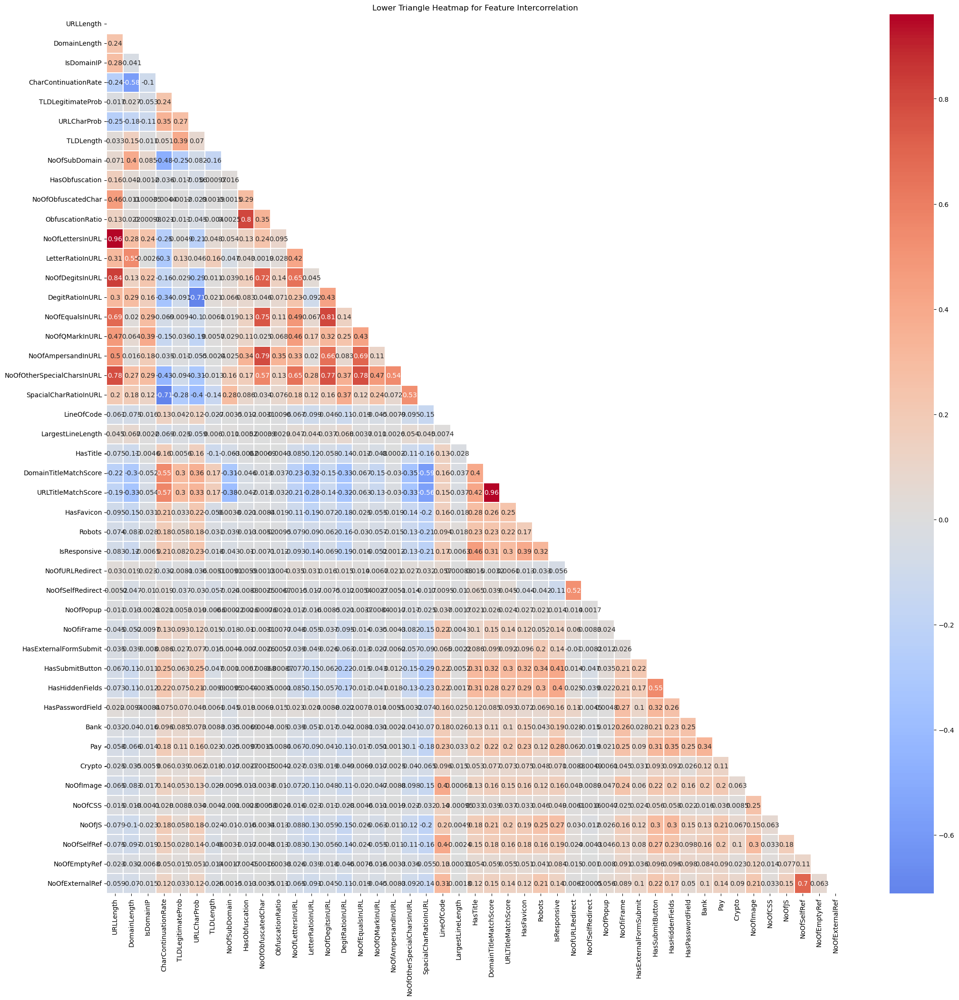

In [54]:
#creating correlation heatmap

reduced_phish_corr = reduced_phish.corr() #creating an intercorrelation variable use .corr

mask = np.triu(np.ones_like(reduced_phish_corr, 
                            dtype=bool)) #setting a mask to reduce redundancy by removing top half

plt.figure(figsize=(25, 24))
sns.heatmap(reduced_phish_corr, 
            mask=mask, 
            annot= True,
            cmap='coolwarm', 
            center=0, 
            linewidths=0.1)
plt.title('Lower Triangle Heatmap for Feature Intercorrelation')
plt.show()

### <span style="color: red;"> Features Dropped - Iteration 1 - Preprocessing</span> <a id="10"></a>

To reduce redundancy, we will remove features that have a correlation under -0.6 and above 0.6. With that in mind, we will be removing the following features:

<br>(1) URLLength
<br>(2) HasObfuscation
<br>(3) NoOfObfuscationChar
<br>(4) NoOfSelfRef
<br>(5) URLTitleMatchScore

In [55]:
#dropping the features. 
reduced_phish2 = reduced_phish.drop(columns=['URLLength',
                                             'HasObfuscation',
                                             'NoOfObfuscatedChar',
                                             'NoOfSelfRef',
                                            'URLTitleMatchScore'])
#checking intial dataframe size (5 x 45)
reduced_phish.head()


,URLLength,DomainLength,IsDomainIP,CharContinuationRate,TLDLegitimateProb,URLCharProb,TLDLength,NoOfSubDomain,HasObfuscation,NoOfObfuscatedChar,...,HasPasswordField,Bank,Pay,Crypto,NoOfImage,NoOfCSS,NoOfJS,NoOfSelfRef,NoOfEmptyRef,NoOfExternalRef
0,31,24,0,1.000000,0.522907,0.061933,3,1,0,0,...,0,1,0,0,34,20,28,119,0,124
1,23,16,0,0.666667,0.032650,0.050207,2,1,0,0,...,0,0,0,0,50,9,8,39,0,217
2,29,22,0,0.866667,0.028555,0.064129,2,2,0,0,...,0,0,0,0,10,2,7,42,2,5
3,26,19,0,1.000000,0.522907,0.057606,3,1,0,0,...,0,0,1,1,3,27,15,22,1,31
4,33,26,0,1.000000,0.079963,0.059441,3,1,0,0,...,0,1,1,0,244,15,34,72,1,85


In [56]:
#Sanity check to make sure the features were dropped. 
print(f"The number of columns in the dataset is: {reduced_phish2.shape[1]}")

The number of columns in the dataset is: 40


### <span style="color: red;"> Full Correlation Analysis - Iteration 2 - EDA</span> <a id="10"></a>

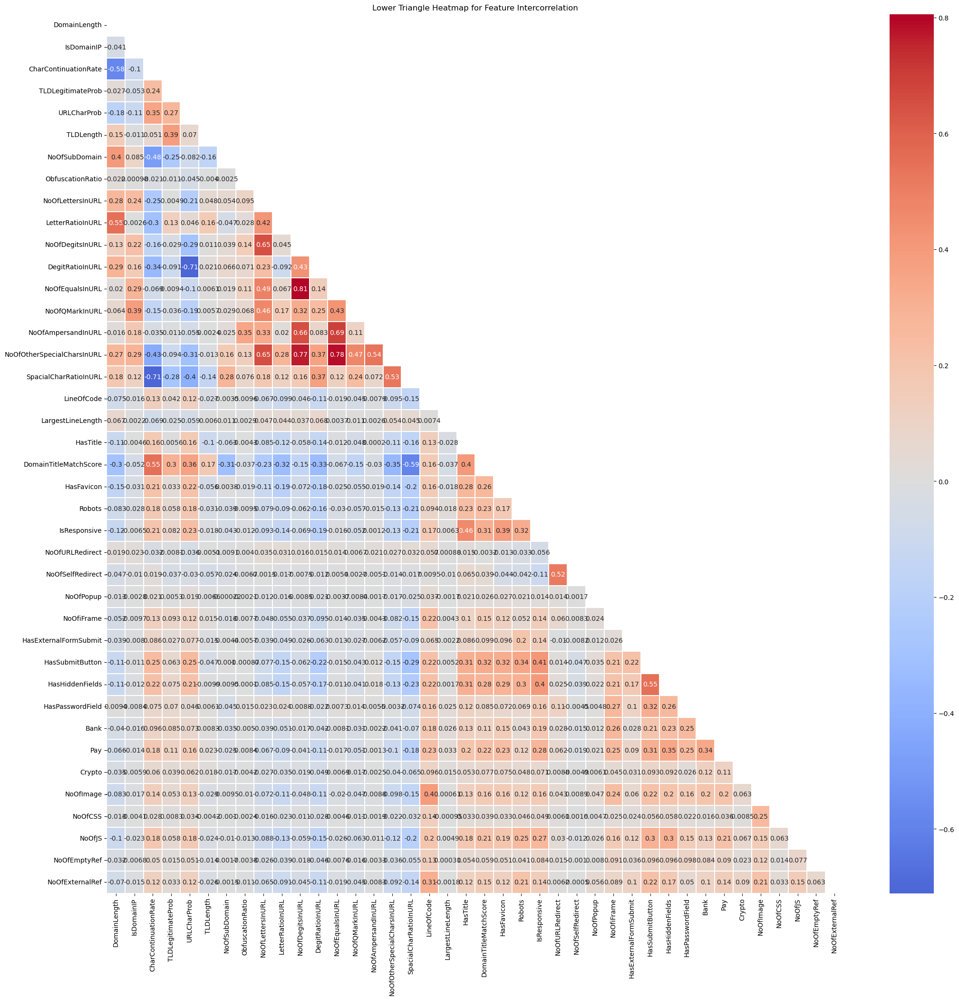

In [57]:
#setting a new correlation variable
reduced_phish_corr2 = reduced_phish2.corr()

mask = np.triu(np.ones_like(reduced_phish_corr2, 
                            dtype=bool)) #setting a mask to reduce redundancy by removing top half

plt.figure(figsize=(25, 24))
sns.heatmap(reduced_phish_corr2, 
            mask=mask, 
            annot= True,
            cmap='coolwarm', 
            center=0, 
            linewidths=0.1)
plt.title('Lower Triangle Heatmap for Feature Intercorrelation')
plt.show()

### <span style="color: red;"> Features Dropped - Iteration 2 - Preprocessing</span> <a id="10"></a>

To reduce redundancy, we will remove features that have a correlation under -0.6 and above 0.6. With that in mind, we will be removing the following features:

<br>(1) NumOfDigitsInURL
<br>(2) NoOfOtherSpecialCharsInURL

In [58]:
#dropping the features. 
reduced_phish3 = reduced_phish2.drop(columns=['NoOfDegitsInURL',
                                             'NoOfOtherSpecialCharsInURL']
                                   )
#checking reduced dataframe size (5 x 40)
reduced_phish2.head()

,DomainLength,IsDomainIP,CharContinuationRate,TLDLegitimateProb,URLCharProb,TLDLength,NoOfSubDomain,ObfuscationRatio,NoOfLettersInURL,LetterRatioInURL,...,HasHiddenFields,HasPasswordField,Bank,Pay,Crypto,NoOfImage,NoOfCSS,NoOfJS,NoOfEmptyRef,NoOfExternalRef
0,24,0,1.000000,0.522907,0.061933,3,1,0.0,18,0.581,...,1,0,1,0,0,34,20,28,0,124
1,16,0,0.666667,0.032650,0.050207,2,1,0.0,9,0.391,...,0,0,0,0,0,50,9,8,0,217
2,22,0,0.866667,0.028555,0.064129,2,2,0.0,15,0.517,...,1,0,0,0,0,10,2,7,2,5
3,19,0,1.000000,0.522907,0.057606,3,1,0.0,13,0.500,...,1,0,0,1,1,3,27,15,1,31
4,26,0,1.000000,0.079963,0.059441,3,1,0.0,20,0.606,...,1,0,1,1,0,244,15,34,1,85


In [59]:
#Sanity check to make sure the features were dropped. We should have 38
print(f"The number of columns in the dataset is: {reduced_phish3.shape[1]}")

The number of columns in the dataset is: 38


### <span style="color: red;"> Full Correlation Analysis - Iteration 3 - EDA</span> <a id="10"></a>

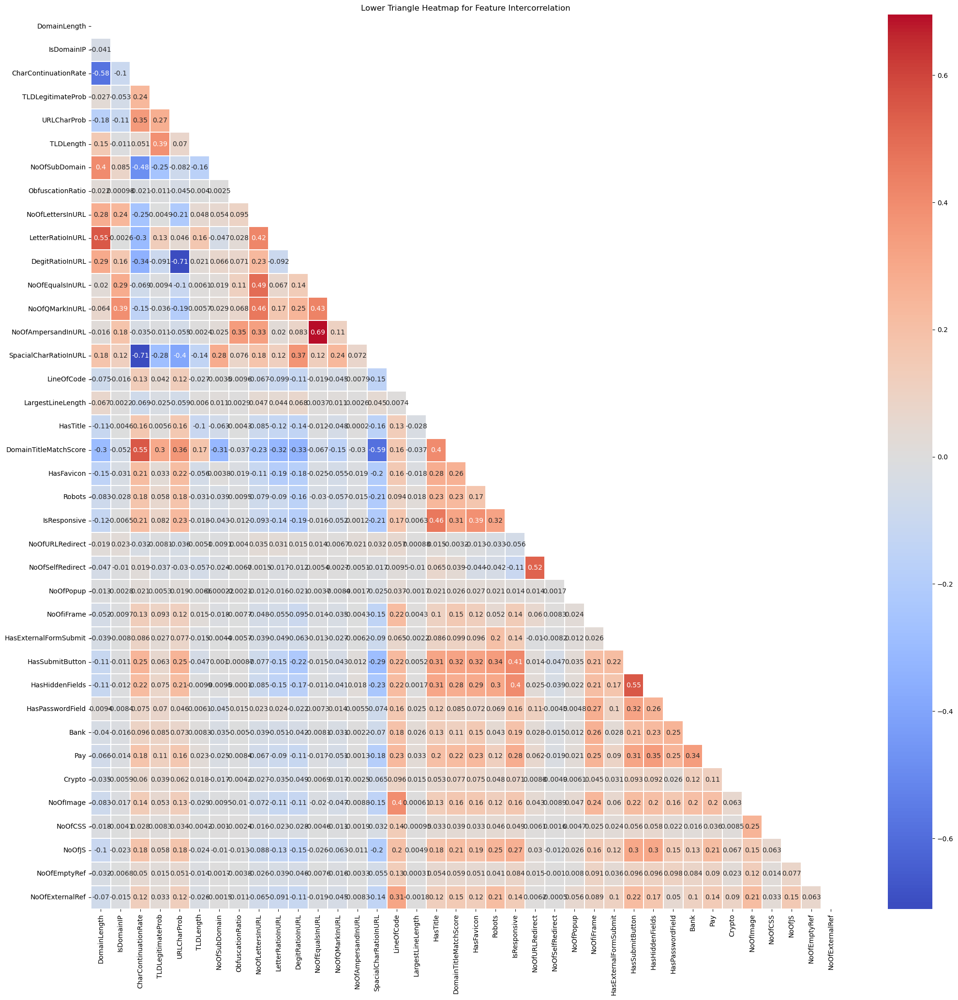

In [60]:
#setting a new correlation variable
reduced_phish_corr3 = reduced_phish3.corr()

mask = np.triu(np.ones_like(reduced_phish_corr3, 
                            dtype=bool)) #setting a mask to reduce redundancy by removing top half

plt.figure(figsize=(25, 24))
sns.heatmap(reduced_phish_corr3, 
            mask=mask, 
            annot= True,
            cmap='coolwarm', 
            center=0, 
            linewidths=0.1)
plt.title('Lower Triangle Heatmap for Feature Intercorrelation')
plt.show()

### <span style="color: red;"> Features Dropped - Iteration 3 - Preprocessing</span> <a id="10"></a>

To reduce redundancy, we will remove features that have a correlation under -0.6 and above 0.6. With that in mind, we will be removing the following features:

<br>(1) CharContinuationRate
<br>(2) URLCharProb
<br>(3) NoOfAmpersandInURL

In [61]:
#dropping the features. 
reduced_phish4 = reduced_phish3.drop(columns=['CharContinuationRate',
                                             'URLCharProb',
                                             'NoOfAmpersandInURL']
                                   )
#checking reduced dataframe size (5 x 38)
reduced_phish3.head()

,DomainLength,IsDomainIP,CharContinuationRate,TLDLegitimateProb,URLCharProb,TLDLength,NoOfSubDomain,ObfuscationRatio,NoOfLettersInURL,LetterRatioInURL,...,HasHiddenFields,HasPasswordField,Bank,Pay,Crypto,NoOfImage,NoOfCSS,NoOfJS,NoOfEmptyRef,NoOfExternalRef
0,24,0,1.000000,0.522907,0.061933,3,1,0.0,18,0.581,...,1,0,1,0,0,34,20,28,0,124
1,16,0,0.666667,0.032650,0.050207,2,1,0.0,9,0.391,...,0,0,0,0,0,50,9,8,0,217
2,22,0,0.866667,0.028555,0.064129,2,2,0.0,15,0.517,...,1,0,0,0,0,10,2,7,2,5
3,19,0,1.000000,0.522907,0.057606,3,1,0.0,13,0.500,...,1,0,0,1,1,3,27,15,1,31
4,26,0,1.000000,0.079963,0.059441,3,1,0.0,20,0.606,...,1,0,1,1,0,244,15,34,1,85


In [62]:
#Sanity check to make sure the features were dropped. We should have 35
print(f"The number of columns in the dataset is: {reduced_phish4.shape[1]}")

The number of columns in the dataset is: 35


## Logistic Regression Model Post Correlation Analysis

#### <span style="color: red;">Modeling</span> <a id="10"></a>

In [63]:
#Setting new X variable with reduced feature set
X = reduced_phish4
y = phish['label'] #Setting target variable
#creating the train test split. 
X_train, X_test, y_train, y_test = train_test_split(X,y,
                                                    test_size = 0.2,
                                                    stratify = y,
                                                    random_state=42)

pipeline = Pipeline([
    ('scaler',StandardScaler()),
    ('logreg',LogisticRegression(max_iter=1000, #setting max iterations to manage depth
     solver = 'liblinear'))])

param_grid = {
    'logreg__C': [0.01, 0.1, 1, 10, 100],
    'logreg__penalty': ['l2']
}

#using the same grid search params as 'baseline' model in the earlier section
grid = GridSearchCV(
    pipeline,
    param_grid,
    cv=5,  # Setting to 5-fold cross-validation
    scoring='f1', 
    verbose=1,
    n_jobs=-1
)

grid.fit(X_train, y_train)

print("Best parameters:", grid.best_params_)
print("Best F1 score from CV:", grid.best_score_)

#best model
best_model = grid.best_estimator_

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best parameters: {'logreg__C': 100, 'logreg__penalty': 'l2'}
Best F1 score from CV: 0.9978402096170083


In [64]:
# Predciting on the training dataset
y_train_pred = best_model.predict(X_train)

#Evaluating the performance of the training model
print("Training Accuracy:", accuracy_score(y_train, y_train_pred))
print("Training Precision:", precision_score(y_train, y_train_pred))
print("Training Recall:", recall_score(y_train, y_train_pred))
print("Training F1 Score:", f1_score(y_train, y_train_pred))
print("\nTraining Confusion Matrix:\n", confusion_matrix(y_train, y_train_pred))
print("\nTraining Classification Report:\n", classification_report(y_train, y_train_pred))

Training Accuracy: 0.9975667422973346
Training Precision: 0.9978864818265246
Training Recall: 0.9978587319243604
Training F1 Score: 0.9978726066825179

Training Confusion Matrix:
 [[ 80528    228]
 [   231 107649]]

Training Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     80756
           1       1.00      1.00      1.00    107880

    accuracy                           1.00    188636
   macro avg       1.00      1.00      1.00    188636
weighted avg       1.00      1.00      1.00    188636



In [65]:
#Predict on the test set
y_pred = best_model.predict(X_test)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))
print("F1 Score:", f1_score(y_test, y_pred))

# Confusion matrix
print("\nConfusion Matrix:")
print(confusion_matrix(y_test, y_pred))

# Detailed classification report
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Accuracy: 0.9977310799635276
Precision: 0.9978501797694503
Recall: 0.9981831664812755
F1 Score: 0.9980166453502382

Confusion Matrix:
[[20131    58]
 [   49 26921]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     20189
           1       1.00      1.00      1.00     26970

    accuracy                           1.00     47159
   macro avg       1.00      1.00      1.00     47159
weighted avg       1.00      1.00      1.00     47159



I checked regularization. 

### <span style="color: red;">(2) Decision Tree Classifier</span> <a id="13"></a>

### <span style="color: red;">(3) Random Forest Classifier</span> <a id="14"></a>

## Bibliography

[1] https://www.samvanderwielen.com/how-to-find-out-if-an-image-is-copyrighted/#:~:text=Check%20the%20Image's%20Metadata,a%20full%2Dblown%20copyright%20manifesto.